In [ ]:
!pip install torch==1.7.1+cu101 torchvision==0.8.2+cu101 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
!pip install fvcore
!pip install pillow==7.2.0
!python -m pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 735.4MB 25kB/s 
     |████████████████████████████████| 12.8MB 248kB/s 
     |████████████████████████████████| 7.6MB 7.5MB/s 
  Found existing installation: torch 1.7.0+cu101
    Uninstalling torch-1.7.0+cu101:
      Successfully uninstalled torch-1.7.0+cu101
  Found existing installation: torchvision 0.8.1+cu101
    Uninstalling torchvision-0.8.1+cu101:
      Successfully uninstalled torchvision-0.8.1+cu101
Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.7.1+cu101)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.8.2+cu101)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-7zfjlq5f
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-7zfjlq5f
     |████████████████████████████████| 276kB 8.2MB/s 
  Created wheel for fvcore: filenam

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
     |████████████████████████████████| 6.6MB 5.2MB/s 


In [ ]:
from detectron2.structures import BoxMode
from detectron2.data import MetadataCatalog, DatasetCatalog
import datetime
import json
import os
def get_teeth_dicts(json_dir):
    json_file = json_dir
    with open(json_file) as f:
        imgs_anns = json.load(f)
    check = []
    for z in range(len(imgs_anns['images'])):
      record = {}
      record['file_name'] = imgs_anns['images'][z]['file_name']
      record['image_id'] = imgs_anns['images'][z]['id']
      record['width'] = imgs_anns['images'][z]['width']
      record['height'] = imgs_anns['images'][z]['height']
      anno_list = []
      for i in range(len(imgs_anns['annotations'])):
        anno = {}
        if imgs_anns['images'][z]['id'] == imgs_anns['annotations'][i]['image_id']:
          anno['bbox'] = imgs_anns['annotations'][i]['bbox'].copy() #check
          anno['bbox_mode'] = BoxMode.XYWH_ABS
          anno['segmentation'] = []
          anno['category_id'] = imgs_anns['annotations'][i]['category_id'] #check
          anno_list.append(anno)
      record['annotations'] = anno_list
      check.append(record)
    return check

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [ ]:
cd ./data/horizontal_dataset

/content/drive/My Drive/horizontal_dataset


In [ ]:
for d in ["train","test"]:
    DatasetCatalog.register("teeth_"+d, lambda d=d: get_teeth_dicts("/content/drive/My Drive/horizontal_dataset/" + d + ".json")) #디렉토리 확인
    MetadataCatalog.get("teeth_"+d).set(thing_classes=["Upper molar", "Upper premolar", "Upper Canine",
                                                       "Upper Lateral incisor", "Upper Central incisor",
                                                       "Lower molar", "Lower premolar", "Lower Canine",
                                                       "Lower Lateral incisor", "Lower Central incisor",'Implant'])


train_teeth_metadata = MetadataCatalog.get("teeth_train")
test_teeth_metadata = MetadataCatalog.get("teeth_test")

Horizontal_Train_Img


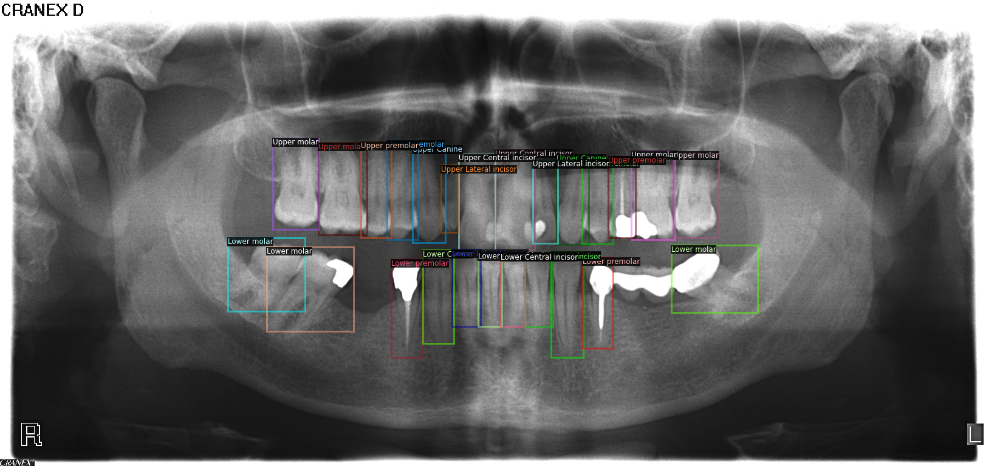

Horizontal_Train_Img


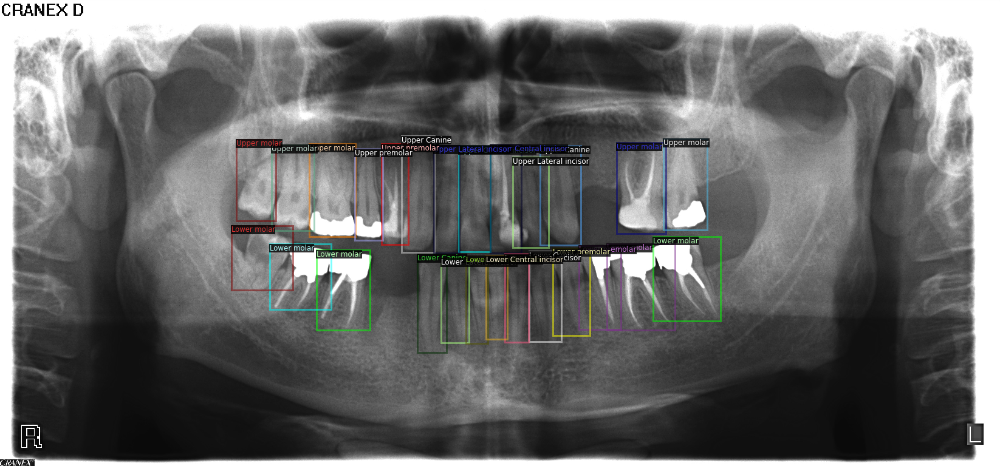

Horizontal_Train_Img


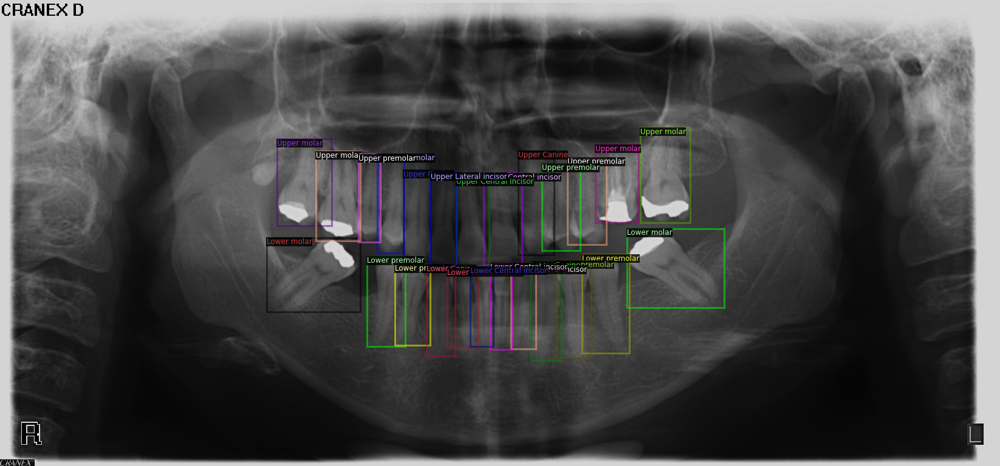

Horizontal_Test_Img


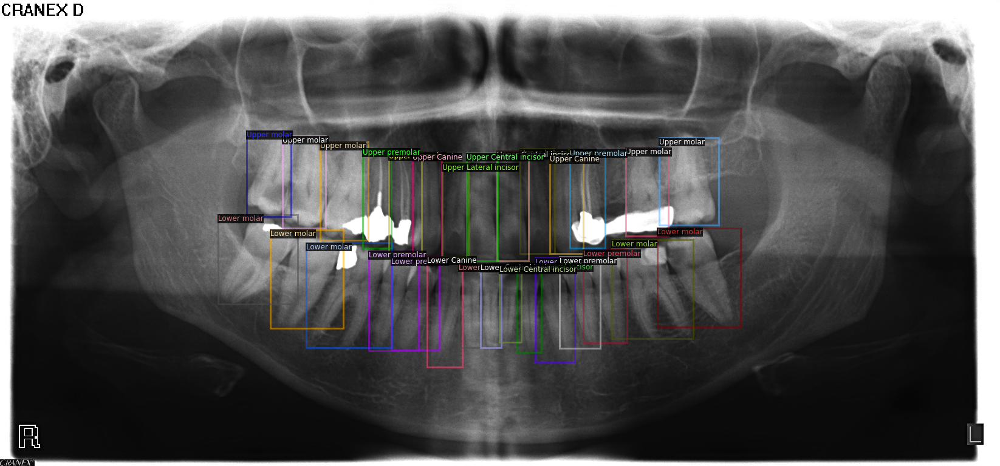

Horizontal_Test_Img


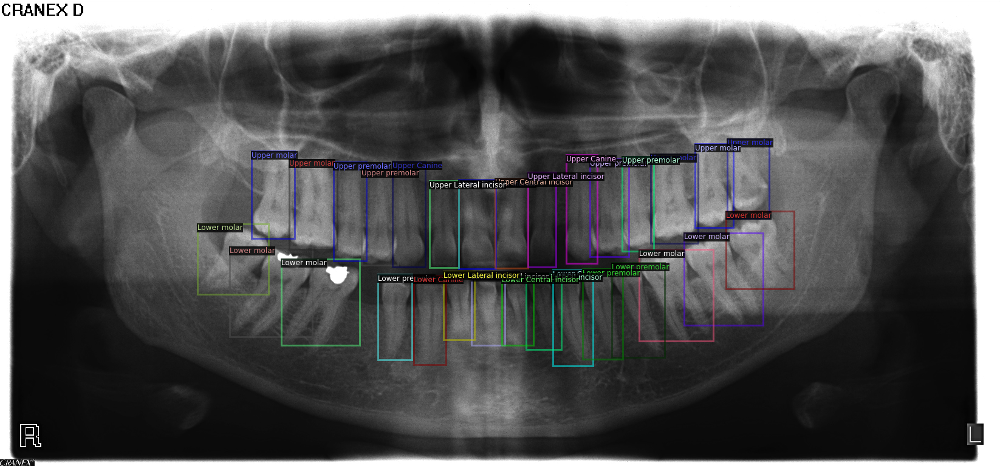

Horizontal_Test_Img


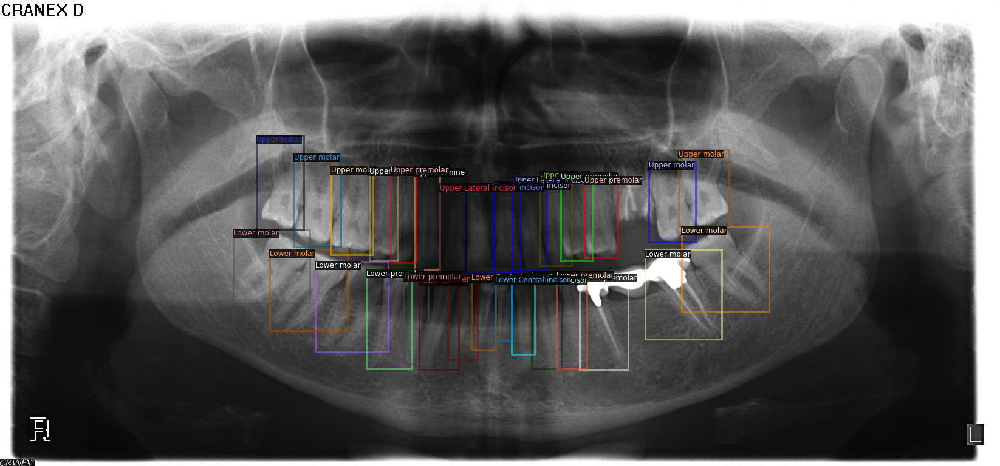

In [ ]:
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import Visualizer

dataset_dicts = get_teeth_dicts("/content/drive/My Drive/horizontal_dataset/train.json")
for d in random.sample(dataset_dicts,3):
    print("Horizontal_Train_Img")
    img = cv2.imread("/content/drive/My Drive/horizontal_dataset/" + d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=train_teeth_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

dataset_dicts = get_teeth_dicts("/content/drive/My Drive/horizontal_dataset/test.json")
for d in random.sample(dataset_dicts,3):
    print("Horizontal_Test_Img")
    img = cv2.imread("/content/drive/My Drive/horizontal_dataset/" + d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=test_teeth_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
model = ["COCO-Detection/faster_rcnn_R_50_FPN_1x.yaml",
         "COCO-Detection/faster_rcnn_R_50_C4_3x.yaml",
         "COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml",
         "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml",
         "COCO-Detection/faster_rcnn_R_101_C4_3x.yaml",
         "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml",
         "COCO-Detection/retinanet_R_101_FPN_3x.yaml"]

input_model = model[5]

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo


cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(input_model))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(input_model)  # Let training initialize from model zoo

cfg.DATASETS.TRAIN = ("teeth_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2

cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00250  # pick a good LR
cfg.SOLVER.WEIGHT_DECAY = 0.0001 ## by Rotated Faster R-CNN for Oriented Object Detection
cfg.SOLVER.MAX_ITER = 2000   

cfg.MODEL.RPN.NMS_THRESH = 0.5 ## by Rotated Faster R-CNN for Oriented Object Detection
cfg.MODEL.RPN.POSITIVE_FRACTION = 0.7 ## by Rotated Faster R-CNN for Oriented Object Detection


cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 17  # only has one class (ballon)
cfg.OUTPUT_DIR = 'horizontal_output'

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)

[12/30 13:19:47 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:05, 74.8MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (18, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (18,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (68, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (68,) in the model! You might want to double check if this is expected.


In [ ]:
trainer.train()

[12/30 13:19:53 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  num_fg = fg_inds.nonzero().numel()


[12/30 13:20:23 d2.utils.events]:  eta: 0:46:19  iter: 19  total_loss: 4.017  loss_cls: 2.908  loss_box_reg: 0.5478  loss_rpn_cls: 0.3497  loss_rpn_loc: 0.1891  time: 1.4084  data_time: 0.0908  lr: 4.9952e-05  max_mem: 5658M
[12/30 13:20:52 d2.utils.events]:  eta: 0:47:03  iter: 39  total_loss: 3.135  loss_cls: 2.24  loss_box_reg: 0.6141  loss_rpn_cls: 0.08811  loss_rpn_loc: 0.1474  time: 1.4280  data_time: 0.0054  lr: 9.9902e-05  max_mem: 5658M
[12/30 13:21:23 d2.utils.events]:  eta: 0:47:22  iter: 59  total_loss: 1.975  loss_cls: 1.139  loss_box_reg: 0.5922  loss_rpn_cls: 0.05709  loss_rpn_loc: 0.1247  time: 1.4666  data_time: 0.0055  lr: 0.00014985  max_mem: 5658M
[12/30 13:21:53 d2.utils.events]:  eta: 0:47:22  iter: 79  total_loss: 1.658  loss_cls: 0.9586  loss_box_reg: 0.5544  loss_rpn_cls: 0.02989  loss_rpn_loc: 0.1087  time: 1.4713  data_time: 0.0055  lr: 0.0001998  max_mem: 5658M
[12/30 13:22:23 d2.utils.events]:  eta: 0:47:09  iter: 99  total_loss: 1.562  loss_cls: 0.8657  lo

In [ ]:
!--logdir

/bin/bash: --: invalid option
Usage:	/bin/bash [GNU long option] [option] ...
	/bin/bash [GNU long option] [option] script-file ...
GNU long options:
	--debug
	--debugger
	--dump-po-strings
	--dump-strings
	--help
	--init-file
	--login
	--noediting
	--noprofile
	--norc
	--posix
	--rcfile
	--restricted
	--verbose
	--version
Shell options:
	-ilrsD or -c command or -O shopt_option		(invocation only)
	-abefhkmnptuvxBCHP or -o option


In [ ]:
%load_ext tensorboard
%tensorboard --logdir horizontal_output/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
from detectron2.engine import DefaultPredictor

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold for this model
cfg.DATASETS.TEST = ("teeth_test", )
predictor = DefaultPredictor(cfg)
print(cfg.OUTPUT_DIR)

horizontal_output


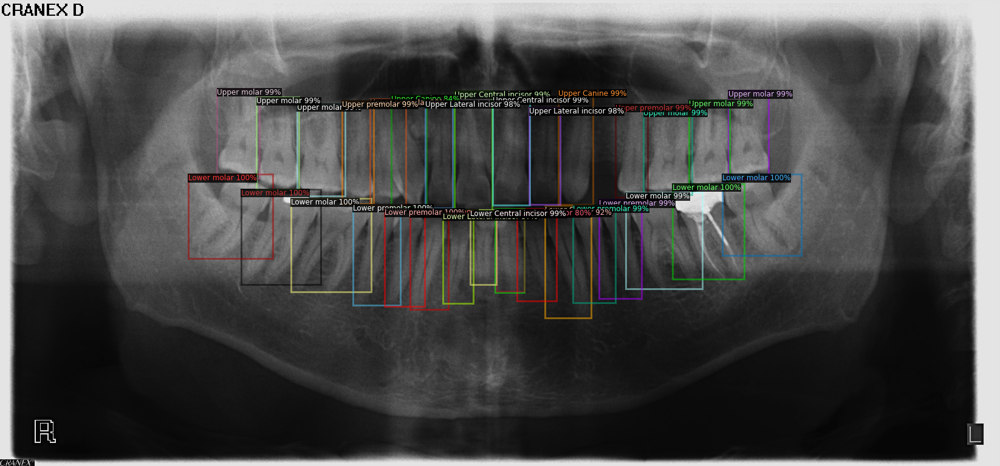

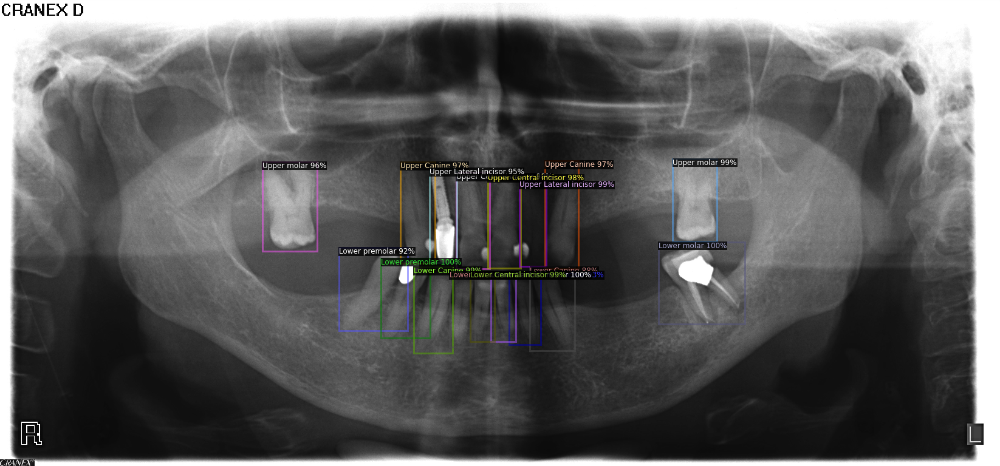

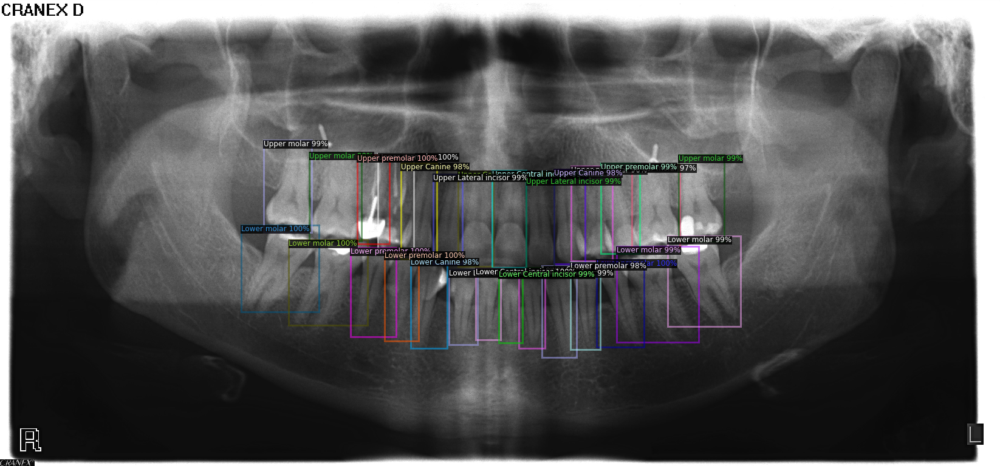

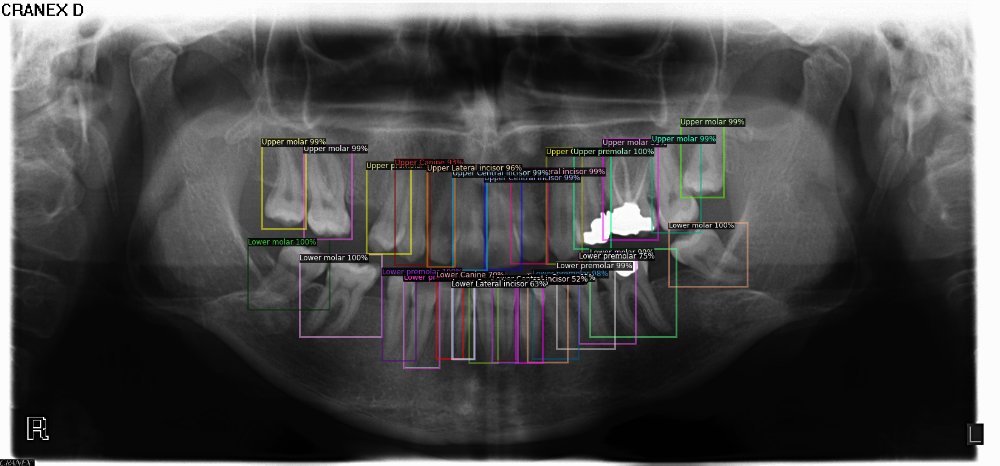

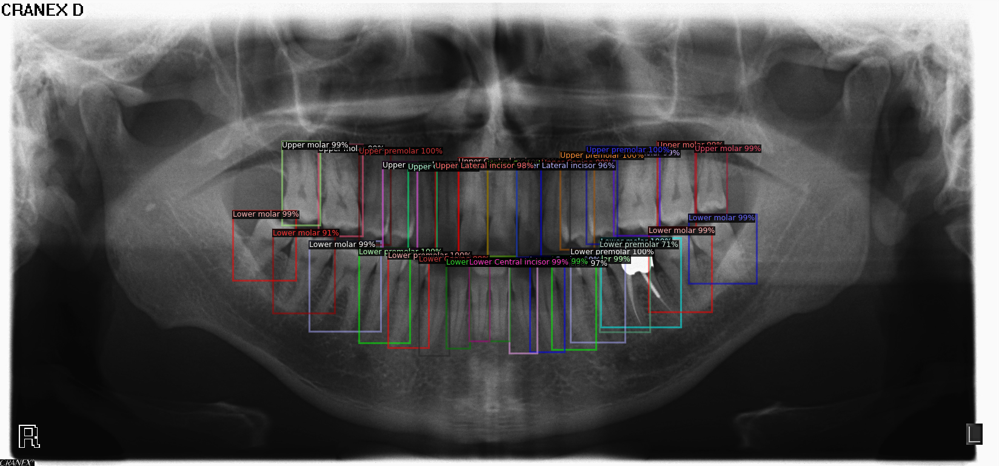

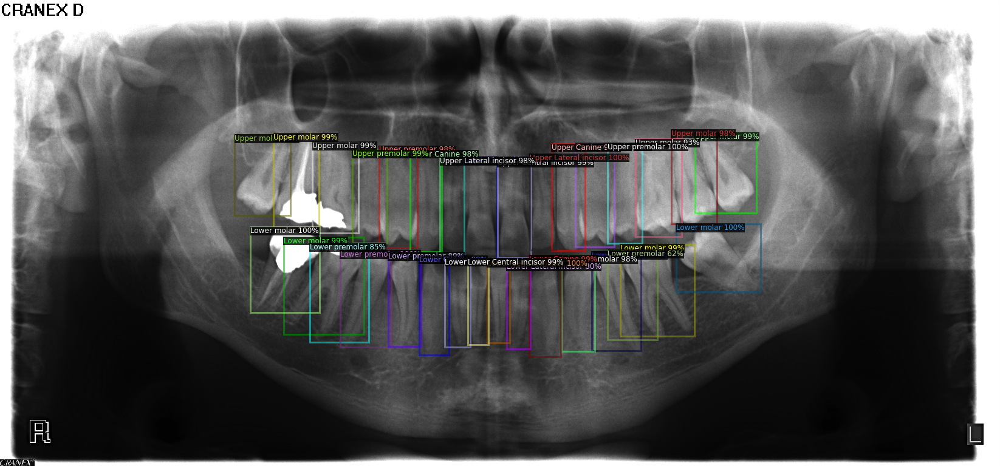

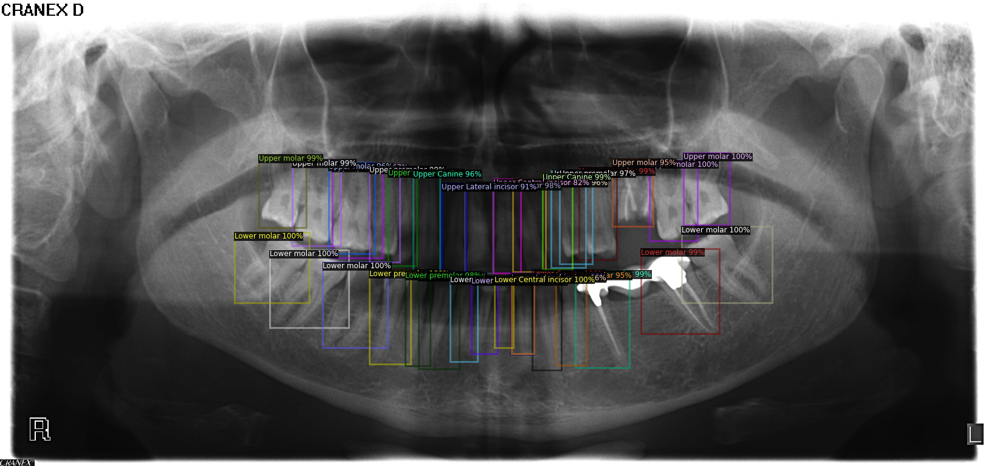

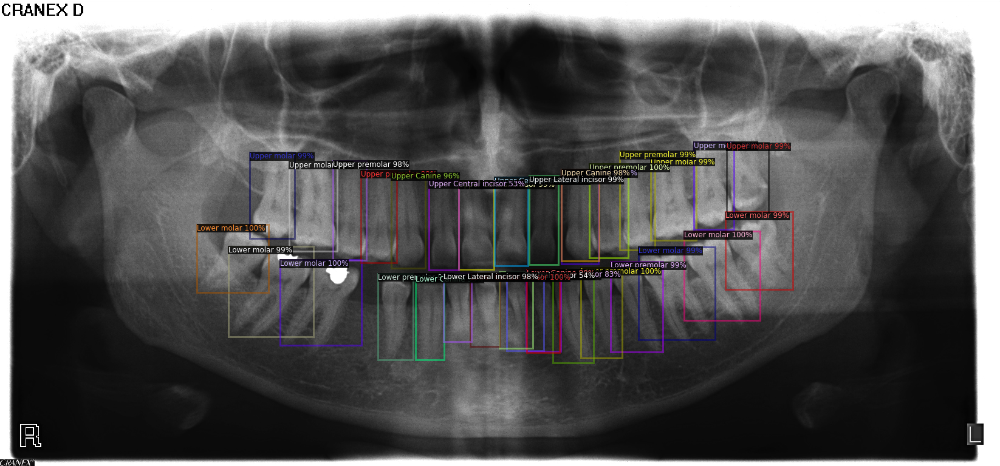

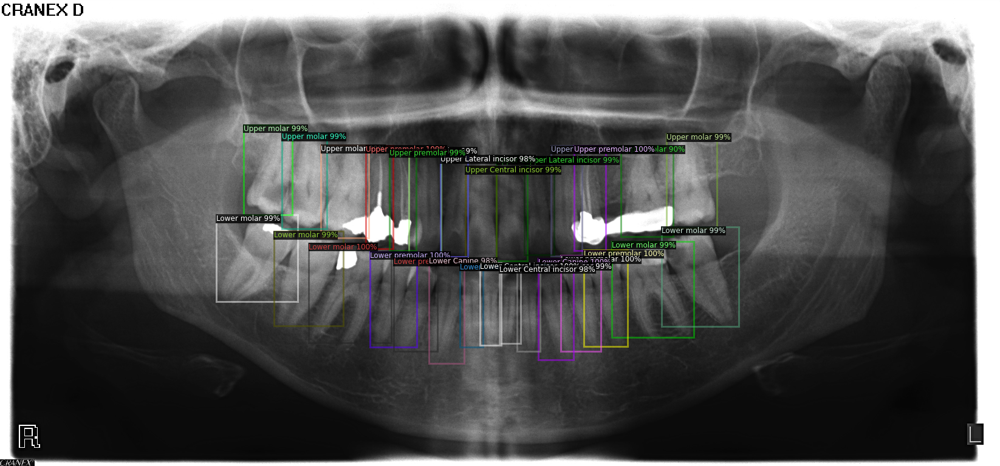

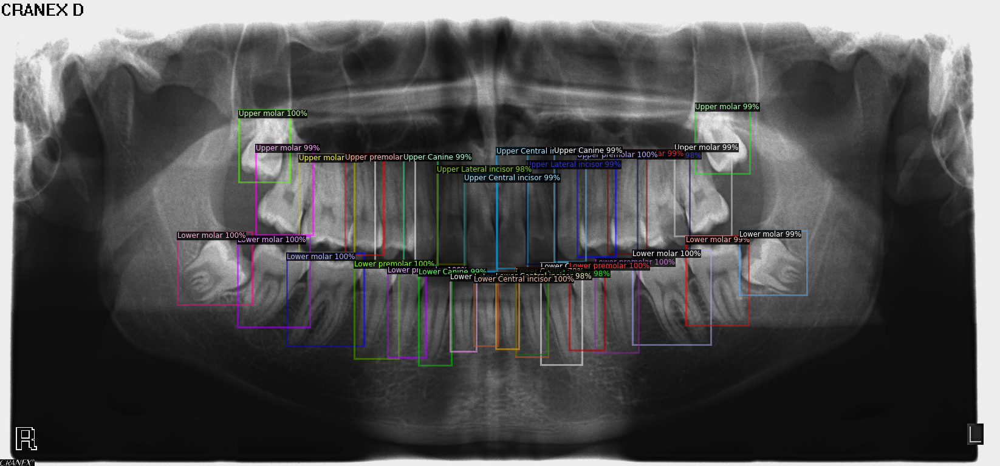

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_teeth_dicts("/content/drive/My Drive/horizontal_dataset/test.json")
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=train_teeth_metadata, 
                   scale=0.5,
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("teeth_test", cfg, False, output_dir="./rename_output/")
val_loader = build_detection_test_loader(cfg, "teeth_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [12/30 14:10:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[12/30 14:10:41 d2.evaluation.coco_evaluation]: 'teeth_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
WARNING [12/30 14:10:41 d2.data.datasets.coco]: Using previously cached COCO format annotations at './rename_output/teeth_test_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[12/30 14:10:41 d2.data.build]: Distribution of instances among all 11 categories:
|   category    | #instances   |   category    | #instances   |   category    | #instances   |
|:-------------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
|  Upper molar  | 49           | Upper premo.. | 32           | Upper Canine  | 20           |
| Upper Later.. | 18           | Upper Centr.. | 20           |  Lower molar  | 48           |
| Lower

In [ ]:
!nvidia-smi

Wed Dec 30 14:10:46 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   76C    P0    45W /  70W |   7315MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------